#1).....Extracting feature with ResNet50 Network......

In [2]:
!unzip /content/roundlog.zip

Archive:  /content/roundlog.zip
  inflating: roundlog/Arjun(1).jpg   
  inflating: roundlog/Arjun(10).jpg  
  inflating: roundlog/Arjun(11).jpg  
  inflating: roundlog/Arjun(12).jpg  
  inflating: roundlog/Arjun(13).jpg  
  inflating: roundlog/Arjun(14).jpg  
  inflating: roundlog/Arjun(15).jpg  
  inflating: roundlog/Arjun(16).jpg  
  inflating: roundlog/Arjun(17).jpg  
  inflating: roundlog/Arjun(18).jpg  
  inflating: roundlog/Arjun(19).jpg  
  inflating: roundlog/Arjun(2).jpg   
  inflating: roundlog/Arjun(20).jpg  
  inflating: roundlog/Arjun(21).jpg  
  inflating: roundlog/Arjun(22).jpg  
  inflating: roundlog/Arjun(23).jpg  
  inflating: roundlog/Arjun(24).jpg  
  inflating: roundlog/Arjun(25).jpg  
  inflating: roundlog/Arjun(26).jpg  
  inflating: roundlog/Arjun(27).jpg  
  inflating: roundlog/Arjun(28).jpg  
  inflating: roundlog/Arjun(29).jpg  
  inflating: roundlog/Arjun(3).jpg   
  inflating: roundlog/Arjun(30).jpg  
  inflating: roundlog/Arjun(31).jpg  
  inflating: round

In [75]:
from os import listdir
from pickle import dump
from keras.applications.resnet import ResNet50
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.applications.vgg19 import preprocess_input
from keras.models import Model

# extract features from each photo in the directory
def extract_features(directory):
	# load the model

	model = ResNet50()
 
	# re-structure the model
	model.layers.pop()
	model = Model(inputs=model.inputs, outputs=model.layers[-1].output)
	# summarize
	print(model.summary())
	# extract features from each photo
	features = dict()
	for name in listdir(directory):
		# load an image from file
		filename = directory + '/' + name
		image = load_img(filename, target_size=(224, 224))
		# convert the image pixels to a numpy array
		image = img_to_array(image)
		# reshape data for the model
		image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
		# prepare the image for the VGG model
		image = preprocess_input(image)
		# get features
		feature = model.predict(image, verbose=0)
		# get image id
		image_id = name.split('.')[0]
		# store feature
		features[image_id] = feature
		print('>%s' % name)
	return features

# extract features from all images
directory = 'roundlog'
features = extract_features(directory)
print('Extracted Features: %d' % len(features))
# save to file
dump(features, open('tree_features.pkl', 'wb'))

102981632/102967424 [==============================] - 1s 0us/step
Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_3[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                         

# 2).....Import The Pkl File,Check features..........

In [76]:
import pickle
pickle_in = open("tree_features.pkl","rb")
features = pickle.load(pickle_in)

In [77]:
len(features)

961

In [78]:
features['Arjun(1)'][0,10:100]

array([5.9087154e-07, 1.9746150e-07, 7.3598147e-07, 5.4880529e-06,
       9.0886010e-07, 7.9298303e-08, 3.4961838e-07, 2.2017657e-06,
       3.1507946e-07, 1.3350641e-06, 1.5416753e-06, 2.3242464e-08,
       3.9832187e-08, 7.6430115e-07, 1.3222563e-06, 3.1122358e-06,
       4.2234617e-05, 1.2728949e-04, 1.0051025e-06, 9.1130801e-08,
       5.1730471e-08, 8.0948048e-06, 1.1629271e-05, 7.6207293e-06,
       3.9997472e-06, 4.2354168e-05, 2.6623831e-05, 3.1804655e-05,
       1.4975427e-04, 1.4363959e-05, 1.4418721e-05, 1.8995030e-05,
       8.2856030e-05, 3.8408692e-04, 7.3165596e-05, 3.1988948e-06,
       1.7154855e-05, 2.9408577e-05, 3.6095904e-07, 6.6364322e-07,
       1.6961508e-07, 2.6397463e-06, 2.2768693e-06, 1.7572064e-06,
       9.8902410e-06, 2.9744182e-08, 4.6644068e-06, 8.4783773e-07,
       2.0397076e-06, 1.8118944e-07, 4.9403525e-06, 1.8156489e-06,
       1.9131434e-07, 4.6578654e-07, 2.2725251e-07, 9.6781941e-06,
       6.1532310e-06, 7.9771576e-07, 1.7990798e-06, 7.5826983e

In [79]:
features

{'Arjun(1)': array([[8.60468745e-08, 2.94302502e-08, 3.20741577e-07, 2.62606665e-08,
         1.35524283e-06, 9.54273855e-05, 3.66003883e-06, 3.74254284e-07,
         2.90438879e-06, 4.43534390e-07, 5.90871537e-07, 1.97461503e-07,
         7.35981473e-07, 5.48805292e-06, 9.08860102e-07, 7.92983030e-08,
         3.49618375e-07, 2.20176571e-06, 3.15079461e-07, 1.33506410e-06,
         1.54167526e-06, 2.32424640e-08, 3.98321873e-08, 7.64301149e-07,
         1.32225625e-06, 3.11223585e-06, 4.22346166e-05, 1.27289488e-04,
         1.00510249e-06, 9.11308007e-08, 5.17304706e-08, 8.09480480e-06,
         1.16292713e-05, 7.62072932e-06, 3.99974715e-06, 4.23541678e-05,
         2.66238312e-05, 3.18046550e-05, 1.49754269e-04, 1.43639591e-05,
         1.44187206e-05, 1.89950297e-05, 8.28560296e-05, 3.84086918e-04,
         7.31655964e-05, 3.19889477e-06, 1.71548545e-05, 2.94085767e-05,
         3.60959035e-07, 6.63643220e-07, 1.69615078e-07, 2.63974630e-06,
         2.27686928e-06, 1.75720641e-06

In [80]:
label = {}

# 3)......... Class Create for Tree Classification.....

In [81]:
def get_class(ipt):
    class_id = 0
    if 'Arjun' in ipt : 
        class_id = 1
    elif 'Ashoke' in ipt : 
        class_id = 2
    elif 'jack fruit' in ipt : 
        class_id = 3
    elif 'jam' in ipt : 
        class_id = 4
    elif  'Litchi' in ipt : 
        class_id = 5
    elif 'Mango' in ipt : 
        class_id = 6
    elif  'Mehgoni' in ipt : 
        class_id = 7
    elif  'Neem' in ipt : 
        class_id = 8
    elif  'pahari gamar' in ipt : 
        class_id = 9
    elif  'Raj koroi' in ipt : 
        class_id = 10
    elif  'Segun' in ipt : 
        class_id = 11
    elif  'Tamarind' in ipt : 
        class_id = 12
    elif  'Ucliptus' in ipt : 
        class_id = 13
    else :
     print("I don't know")

    return class_id

In [ ]:
for key, value in features.items() :
    label[key] = get_class(key)

In [83]:
get_class('Tamarind(3)')

12

In [84]:
label['Tamarind(3)']

12

# 4).....Create Numpy Array, Train Test Splite......

In [85]:
x = []
y = []

In [86]:
for key, value in features.items() :
    x.append(features[key][0])
    y.append(label[key])

In [87]:
import numpy as np
x=np.array(x)
y=np.array(y)

In [88]:
x[1].shape

(1000,)

In [89]:
print (type(x))
print (type(y))

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [90]:
import numpy as np
x_train_data=np.array(x)
y_train_data=np.array(y)

In [91]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.1, random_state=800, shuffle=True)
#x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=800, shuffle=True)

#5)...Check Train Test Accuracy With KNN

In [92]:
from sklearn.neighbors import KNeighborsClassifier

clf=KNeighborsClassifier(n_neighbors=3)

clf.fit(x_train,y_train)
y_predict = clf.predict(x_test)
print("Accuracy: {}%".format(clf.score(x_test, y_test) * 100 ))

Accuracy: 15.463917525773196%


#6)Clasiification report (precision, recall,f1-score)

In [93]:
from sklearn.metrics import classification_report, confusion_matrix
#class_names = get_class
print(classification_report(y_test, y_predict))
print(confusion_matrix(y_test, y_predict))

              precision    recall  f1-score   support

           0       0.15      0.36      0.21        11
           1       0.10      0.20      0.13         5
           2       0.00      0.00      0.00         9
           3       0.10      0.17      0.12        12
           4       0.17      0.11      0.13         9
           5       0.00      0.00      0.00         2
           6       0.33      0.27      0.30        11
           7       0.00      0.00      0.00         5
           8       0.38      0.23      0.29        13
           9       0.00      0.00      0.00         1
          10       0.33      0.14      0.20         7
          11       0.00      0.00      0.00         3
          12       0.00      0.00      0.00         4
          13       0.00      0.00      0.00         5

    accuracy                           0.15        97
   macro avg       0.11      0.11      0.10        97
weighted avg       0.16      0.15      0.15        97

[[4 0 4 1 0 0 0 0 0 0 1 0

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


#7)Confusion matrix

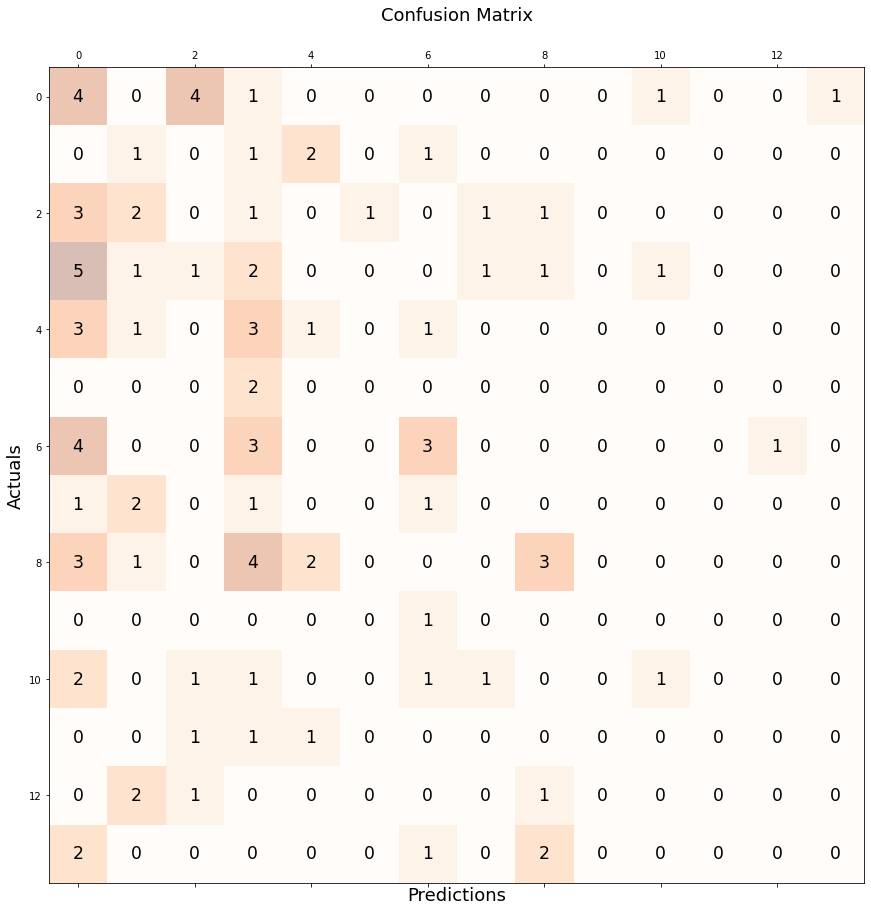

In [94]:
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
import matplotlib.pyplot as plt
conf_matrix = confusion_matrix(y_true=y_test, y_pred=y_predict)
#
# Print the confusion matrix using Matplotlib
#
fig, ax = plt.subplots(figsize=(15, 15))
ax.matshow(conf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
for i in range(conf_matrix.shape[0]):
    for j in range(conf_matrix.shape[1]):
        ax.text(x=j, y=i,s=conf_matrix[i, j], va='center', ha='center', size='xx-large')
 
plt.xlabel('Predictions', fontsize=18)
plt.ylabel('Actuals', fontsize=18)
plt.title('Confusion Matrix', fontsize=18)
plt.show()

#8)...Check Train Test Accuracy With Random Forest

In [95]:
from sklearn.ensemble import RandomForestClassifier

clf=RandomForestClassifier(n_estimators=40)

clf.fit(x_train,y_train)
y_predict = clf.predict(x_test)
print("Accuracy: {}%".format(clf.score(x_test, y_test) * 100 ))

Accuracy: 26.804123711340207%


#9)...Check Train Test Accuracy With SVM,Roc Curve, PRC

In [96]:
#train accuracy for Svm
from sklearn import svm
clf = svm.SVC(kernel='rbf', C = 10.0, gamma=0.1)
clf.fit(x_train, y_train)
y_predict = clf.predict(x_train)
print("Accuracy: {}%".format(clf.score(x_train, y_train) * 100 ))

Accuracy: 16.087962962962962%


In [97]:
#test Accuracy for Svm
from sklearn import svm
clf = svm.SVC(kernel='rbf', C = 10.0, gamma=0.1)

#clf = svm.SVC(kernel='poly')

clf.fit(x_train, y_train)
y_predict = clf.predict(x_test)
print("Accuracy: {}%".format(clf.score(x_test, y_test) * 100 ))

Accuracy: 14.432989690721648%


In [98]:
!pip install scikit-plot

<module 'scikitplot' from '/usr/local/lib/python3.7/dist-packages/scikitplot/__init__.py'>

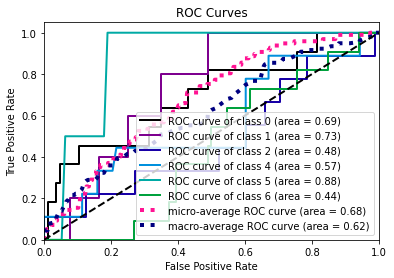

In [99]:
# roc Curve For Svm
import scikitplot as plt
from sklearn import svm
clf = svm.SVC(probability=True)
clf = clf.fit(x_train, y_train)
y_probas = clf.predict_proba(x_test)
plt.metrics.plot_roc(y_test, y_probas, title='ROC Curves', plot_micro=True, plot_macro=True, classes_to_plot=[0,1,2,4,5,6], ax=None, figsize=None, cmap='nipy_spectral', title_fontsize='large', text_fontsize='medium')
plt

<module 'scikitplot' from '/usr/local/lib/python3.7/dist-packages/scikitplot/__init__.py'>

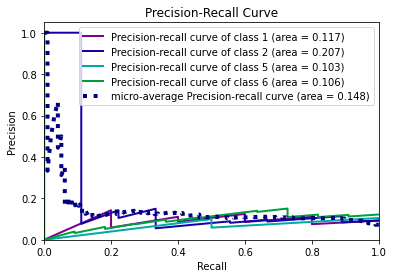

In [100]:
#Precision-Recall Curve for svm
import scikitplot as skplt
clf = svm.SVC(probability=True)
clf = clf.fit(x_train, y_train)
y_probas = clf.predict_proba(x_test)
skplt.metrics.plot_precision_recall(y_test, y_probas, title='Precision-Recall Curve', plot_micro=True, classes_to_plot=[1,2,5,6], ax=None, figsize=None, cmap='nipy_spectral', title_fontsize='large', text_fontsize='medium')

plt

#9)...Check Train Test Accuracy With Logistic Regression,Roc Curve, PRC

In [101]:
#train accuracy for Logistic regression
from sklearn.linear_model import LogisticRegression
clf=LogisticRegression()
clf.fit(x_train, y_train)
y_predict = clf.predict(x_train)
print("Accuracy: {}%".format(clf.score(x_train, y_train) * 100 ))

Accuracy: 16.319444444444446%


In [102]:
#test accuracy for Logistic regression
from sklearn.linear_model import LogisticRegression
clf=LogisticRegression()
clf.fit(x_train, y_train)
y_predict = clf.predict(x_test)
print("Accuracy: {}%".format(clf.score(x_test, y_test) * 100 ))


Accuracy: 14.432989690721648%


<module 'scikitplot' from '/usr/local/lib/python3.7/dist-packages/scikitplot/__init__.py'>

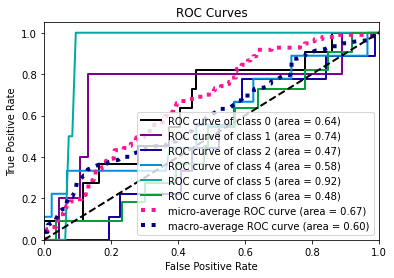

In [103]:
# roc Curve For Logistic Regresion
import scikitplot as skplt
from sklearn.linear_model import LogisticRegression
clfrf=LogisticRegression()
clfrf = clfrf.fit(x_train, y_train)
y_probas = clfrf.predict_proba(x_test)
skplt.metrics.plot_roc(y_test, y_probas, title='ROC Curves', plot_micro=True, plot_macro=True, classes_to_plot=[0,1,2,4,5,6], ax=None, figsize=None, cmap='nipy_spectral', title_fontsize='large', text_fontsize='medium')
plt

<module 'scikitplot' from '/usr/local/lib/python3.7/dist-packages/scikitplot/__init__.py'>

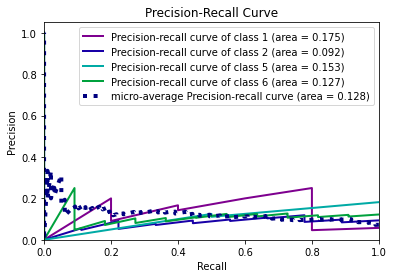

In [104]:
import scikitplot as skplt

from sklearn.linear_model import LogisticRegression
clfknnn = LogisticRegression()
clfknnn = clfknnn.fit(x_train, y_train)
y_probas = clfknnn.predict_proba(x_test)
skplt.metrics.plot_precision_recall(y_test, y_probas, title='Precision-Recall Curve', plot_micro=True, 
classes_to_plot=[1,2,5,6], ax=None, figsize=None, cmap='nipy_spectral', title_fontsize='large', text_fontsize='medium')

plt


#10)......For Increase the accuracy K=5 fold cross Validation.....

In [105]:
from sklearn.model_selection import KFold
kf = KFold(n_splits=4)

kf.get_n_splits(x)
KFold(n_splits=5, random_state=None, shuffle=False)
for train_index, test_index in kf.split(x):
    print("TRAIN:", train_index, "TEST:", test_index)
    X_train, X_test = x[train_index], x[test_index]
    y_train, y_test = y[train_index], y[test_index]

TRAIN: [241 242 243 244 245 246 247 248 249 250 251 252 253 254 255 256 257 258
 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275 276
 277 278 279 280 281 282 283 284 285 286 287 288 289 290 291 292 293 294
 295 296 297 298 299 300 301 302 303 304 305 306 307 308 309 310 311 312
 313 314 315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330
 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348
 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366
 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384
 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401 402
 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485

In [106]:
from sklearn.model_selection import cross_val_score
from sklearn import svm
clf = svm.SVC(kernel='linear')
scores = cross_val_score(clf, x, y, cv=5)
scores
print("Accuracy: %0.2f (+/- %0.2f)" % ((scores.mean())*100, scores.std() * 2))

Accuracy: 13.11 (+/- 0.04)
